In [1]:
from pyvirtualdisplay import Display
display = Display(visible=0, size=(1024, 768))
display.start()


from matplotlib import pyplot as plt, animation
%matplotlib inline
from IPython import display

def create_anim(frames, dpi, fps):
    plt.figure(figsize=(frames[0].shape[1] / dpi, frames[0].shape[0] / dpi), dpi=dpi)
    patch = plt.imshow(frames[0])
    def setup():
        plt.axis('off')
    def animate(i):
        patch.set_data(frames[i])
    anim = animation.FuncAnimation(plt.gcf(), animate, init_func=setup, frames=len(frames), interval=fps)
    return anim

def display_anim(frames, dpi=72, fps=50):
    anim = create_anim(frames, dpi, fps)
    return anim.to_jshtml()

def save_anim(frames, filename, dpi=72, fps=50):
    anim = create_anim(frames, dpi, fps)
    anim.save(filename)
    
class trigger:
    def __init__(self):
        self._trigger = True

    def __call__(self, e):
        return self._trigger

    def set(self, t):
        self._trigger = t

In [2]:
import gym
import panda_gym
import pprint

env = gym.make('PandaReach-v2')

pybullet build time: May 20 2022 19:44:17


In [3]:
obs = env.reset()
print(obs)

{'observation': array([ 3.84396701e-02, -2.19447219e-12,  1.97400143e-01,  0.00000000e+00,
       -0.00000000e+00,  0.00000000e+00]), 'achieved_goal': array([ 3.84396701e-02, -2.19447219e-12,  1.97400143e-01]), 'desired_goal': array([ 0.11216896, -0.01854226,  0.01879904])}


In [4]:
frames = []

obs = env.reset()
done = False

while not done:
    current_position = obs["observation"][0:3]
    desired_position = obs["desired_goal"][0:3]
    action = 5.0 * (desired_position - current_position)
    frames.append(env.render(mode = 'rgb_array'))
    obs, reward, done, info = env.step(action)

env.close()

/home/akshay/miniconda3/envs/ddpg/lib/python3.8/site-packages/panda_gym/pybullet.py:97: UserWarning: The use of the render method is not recommended when the environment has not been created with render=True. The rendering will probably be weird. Prefer making the environment with option `render=True`. For example: `env = gym.make('PandaReach-v2', render=True)`.
  warnings.warn(


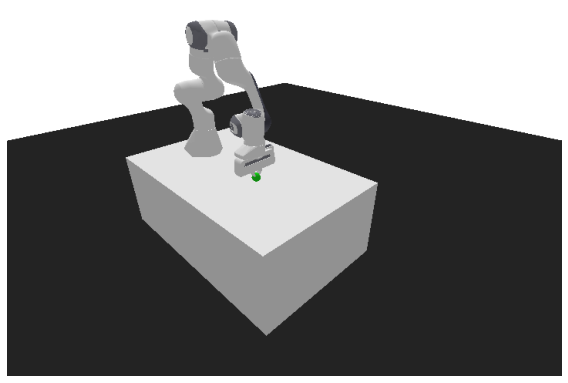

In [5]:
display.HTML(display_anim(frames))

In [8]:
import gym
import panda_gym
import numpy as np
from stable_baselines3 import DDPG, HerReplayBuffer
from stable_baselines3 .common.noise import NormalActionNoise
from sb3_contrib.common.wrappers import TimeFeatureWrapper

rb_kwargs = {'online_sampling' : True,
             'goal_selection_strategy' : 'future',
             'n_sampled_goal' : 4}

policy_kwargs = {'net_arch' : [512, 512, 512], 
                 'n_critics' : 2}

n_actions = env.action_space.shape[0]
noise = NormalActionNoise(mean = np.zeros(n_actions), sigma = 0.1 * np.ones(n_actions))

env = gym.make("PandaReach-v2")
env = TimeFeatureWrapper(env)

model = DDPG(policy="MultiInputPolicy", env=env, replay_buffer_class=HerReplayBuffer, verbose=1, 
             gamma = 0.95, batch_size= 2048, buffer_size=100000, replay_buffer_kwargs = rb_kwargs,
             learning_rate = 1e-3, action_noise = noise, policy_kwargs = policy_kwargs)
model.learn(1e4)
model.save('pick_place/model')

Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 50       |
|    ep_rew_mean     | -48.5    |
|    success_rate    | 0        |
| time/              |          |
|    episodes        | 4        |
|    fps             | 195      |
|    time_elapsed    | 1        |
|    total_timesteps | 200      |
| train/             |          |
|    actor_loss      | 0.562    |
|    critic_loss     | 0.402    |
|    learning_rate   | 0.001    |
|    n_updates       | 50       |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 50       |
|    ep_rew_mean     | -48.4    |
|    success_rate    | 0        |
| time/              |          |
|    episodes        | 8        |
|    fps             | 96       |
|    time_elapsed    | 4        |
|    total_timesteps | 400      |
| train/             

/home/akshay/miniconda3/envs/ddpg/lib/python3.8/site-packages/stable_baselines3/common/save_util.py:278: UserWarning: Path 'pick_place' does not exist. Will create it.
  warnings.warn(f"Path '{path.parent}' does not exist. Will create it.")


In [9]:
model = DDPG.load("pick_place/model", env = env)

frames = []
for _ in range(10):
    done = False
    observation = env.reset()
    while not done:
        action, _states = model.predict(observation, deterministic = True)
        observation, reward, done, info = env.step(action)
        frame = env.render(mode='rgb_array')
        frames.append(frame)

env.close()

Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
argv[0]=--background_color_red=0.8745098039215686
argv[1]=
argv[2]=
argv[3]=
argv[4]=
argv[5]=
argv[6]=
argv[7]=
argv[8]=
argv[9]=
argv[10]=
argv[11]=
argv[12]=
argv[13]=
argv[14]=
argv[15]=
argv[16]=
argv[17]=
argv[18]=
argv[19]=
argv[20]=
argv[21]=--background_color_green=0.21176470588235294
argv[22]=
argv[23]=
argv[24]=
argv[25]=
argv[26]=
argv[27]=
argv[28]=
argv[29]=
argv[30]=
argv[31]=
argv[32]=
argv[33]=
argv[34]=
argv[35]=
argv[36]=
argv[37]=
argv[38]=
argv[39]=
argv[40]=
argv[41]=
argv[42]=--background_color_blue=0.17647058823529413
argv[0]=--background_color_red=0.8745098039215686
argv[1]=
argv[2]=
argv[3]=
argv[4]=
argv[5]=
argv[6]=
argv[7]=
argv[8]=
argv[9]=
argv[10]=
argv[11]=
argv[12]=
argv[13]=
argv[14]=
argv[15]=
argv[16]=
argv[17]=
argv[18]=
argv[19]=
argv[20]=
argv[21]=--background_color_green=0.21176470588235294
argv[22]=
argv[23]=
argv[24]=
argv[25]=
argv[26]=
argv[27]=
argv[28]=
argv[29]=


/home/akshay/miniconda3/envs/ddpg/lib/python3.8/site-packages/panda_gym/pybullet.py:97: UserWarning: The use of the render method is not recommended when the environment has not been created with render=True. The rendering will probably be weird. Prefer making the environment with option `render=True`. For example: `env = gym.make('PandaReach-v2', render=True)`.
  warnings.warn(


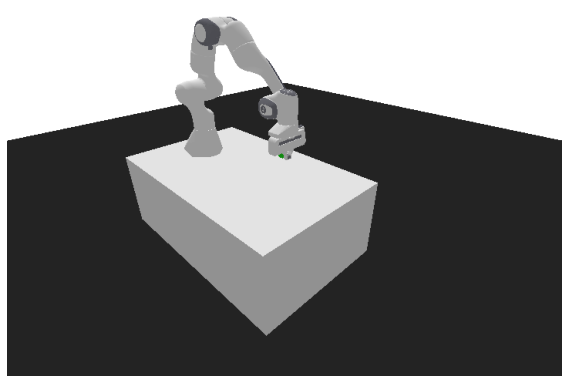

In [10]:
display.HTML(display_anim(frames))